<a href="https://colab.research.google.com/github/JoseJ09/ANOVA_1/blob/main/EDA_Mapbox_Chicago.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#Instalar libreria
!pip install boto3

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#Importar librerias

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import boto3
import yaml
import plotly.express as px

from matplotlib.ticker import FuncFormatter

In [ ]:
def number_formatter(number, pos=None):
    """Convert a number into a human readable format."""
    magnitude = 0
    while abs(number) >= 1000:
        magnitude += 1
        number /= 1000.0
    return '%.1f%s' % (number, ['', 'K', 'M', 'B', 'T', 'Q'][magnitude])

In [ ]:
#Obtener las credenciales del archivo yaml
with open("credentials.yaml", "r") as f:
    config = yaml.safe_load(f)

In [ ]:
#Funcion para cargar datos del bucket
def cargar_datos_s3(bucket, bucket_path):
    session = boto3.Session(
        aws_access_key_id = config['s3']['aws_access_key_id'],
        aws_secret_access_key = config['s3']['aws_secret_access_key'],
        aws_session_token = config['s3']['aws_session_token']
    )

    s3 = session.resource('s3')

    obj = s3.Object(bucket, bucket_path).get()['Body'].read()
    dataset = pickle.loads(obj)

    return dataset

In [ ]:
#Funcion para cargar datos del bucket
session = boto3.Session(
    aws_access_key_id = config['s3']['aws_access_key_id'],
    aws_secret_access_key = config['s3']['aws_secret_access_key'],
    aws_session_token = config['s3']['aws_session_token']
)

s3 = session.client('s3')

In [ ]:
#Seleccionar bucket y ruta
bucket = "aplicaciones-cd-1-" + config['iexe']['matricula']
key = "limpieza/"

In [ ]:
#Obtener path del bucket
bucket_path = s3.list_objects_v2(Bucket=bucket, Prefix=key)['Contents'][-1]['Key']

In [ ]:
#Mostrar path
bucket_path

'limpieza/datos-limpios-2023-04-21.pkl'

In [ ]:
#Se cargan los datos de la limpieza de datos
dataset = cargar_datos_s3(bucket, bucket_path)

In [ ]:
#Como se ven los primeros registros
dataset.head()

,inspection_id,dba_name,aka_name,license_,facility_type,risk,address,city,state,zip,inspection_date,inspection_type,results,violations,latitude,longitude,location
0,104236,TEMPO CAFE,TEMPO CAFE,80916,Restaurant,Risk 1 (High),6 E CHESTNUT ST,CHICAGO,IL,60611,2010-01-04,Canvass,Fail,18. NO EVIDENCE OF RODENT OR INSECT OUTER OPEN...,41.898431,-87.628009,"{'latitude': '41.89843137207629', 'longitude':..."
1,67732,WOLCOTT'S,TROQUET,1992039,Restaurant,Risk 1 (High),1834 W MONTROSE AVE,CHICAGO,IL,60613,2010-01-04,License Re-Inspection,Pass,NaN,41.961606,-87.675967,"{'latitude': '41.961605669949854', 'longitude'..."
2,67733,WOLCOTT'S,TROQUET,1992040,Restaurant,Risk 1 (High),1834 W MONTROSE AVE,CHICAGO,IL,60613,2010-01-04,License Re-Inspection,Pass,NaN,41.961606,-87.675967,"{'latitude': '41.961605669949854', 'longitude'..."
3,70269,mr.daniel's,mr.daniel's,1899292,Restaurant,Risk 1 (High),5645 W BELMONT AVE,CHICAGO,IL,60634,2010-01-04,License Re-Inspection,Pass,NaN,41.938443,-87.768318,"{'latitude': '41.93844282365204', 'longitude':..."
4,52234,Cafe 608,Cafe 608,2013328,Restaurant,Risk 1 (High),608 W BARRY AVE,CHICAGO,IL,60657,2010-01-04,License Re-Inspection,Pass,NaN,41.938007,-87.644755,"{'latitude': '41.938006880423615', 'longitude'..."


### 2. ¿Cuáles son los 5 tipos de establecimientos con más inspecciones en todo el dataset?

In [ ]:
#Agrupamos el dataset por tipo de establecimiento, contamos , renombramos columna, y ordenamos por cantidad
inspections_by_type_stablishment = dataset.groupby(['facility_type'], as_index=False)['inspection_id']\
.count()\
.rename(columns={'inspection_id': 'count'})\
.sort_values(by="count", ascending=False)\
.head(5)

In [ ]:
#Mostramos el tipo de establecimiento y la cantidad de inspecciones
inspections_by_type_stablishment

,facility_type,count
392,Restaurant,168891
221,Grocery Store,31695
411,School,15484
115,Children's Services Facility,5051
2,"0 Restaurant\nName: facility_type, dtype: o...",5037


[Text(0, 0, 'Restaurant'),
 Text(1, 0, 'Grocery Store'),
 Text(2, 0, 'School'),
 Text(3, 0, "Children's Services Facility"),
 Text(4, 0, '0    Restaurant\nName: facility_type, dtype: object')]

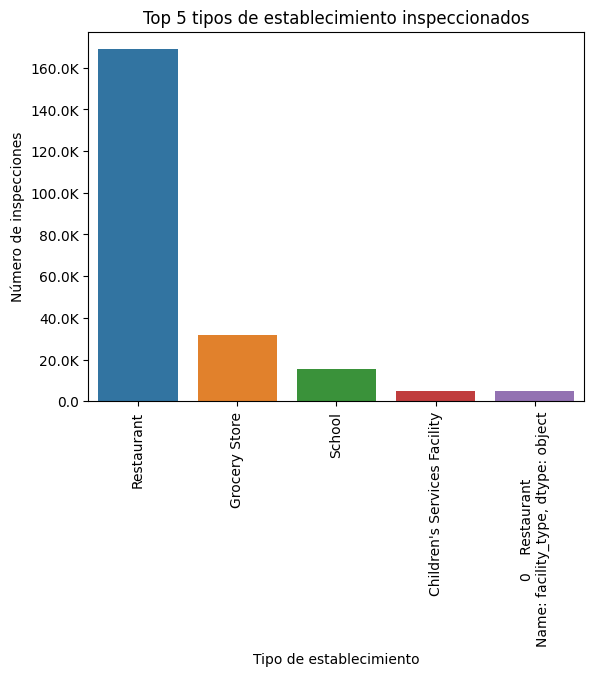

In [ ]:
#Utilizamos seaborn para graficar los 5 establecimientos con más inspecciones
a = sns.barplot(x='facility_type', y='count', data=inspections_by_type_stablishment)
a.set_title("Top 5 tipos de establecimiento inspeccionados")
a.set_xlabel("Tipo de establecimiento")
a.set_ylabel("Número de inspecciones")
a.yaxis.set_major_formatter(FuncFormatter(number_formatter))
a.set_xticklabels(a.get_xticklabels(), rotation=90)

### 3. Cuántas inspecciones tienes por año

In [ ]:
#Creamos columna con el año de inspeccion
dataset['year_inspection'] = dataset.inspection_date.dt.year

In [ ]:
#Comprobamos los tipos de datos
dataset.dtypes

inspection_id               int64
dba_name                   object
aka_name                   object
license_                   object
facility_type              object
risk                       object
address                    object
city                       object
state                      object
zip                        object
inspection_date    datetime64[ns]
inspection_type            object
results                    object
violations                 object
latitude                  float64
longitude                 float64
location                   object
year_inspection             int64
dtype: object

In [ ]:
#Agrupamos el dataset por año de inspección, contamos , renombramos columna, y ordenamos por año
inspections_by_year = dataset.groupby(['year_inspection'], as_index=False)['inspection_id']\
.count()\
.rename(columns={'inspection_id': 'count'})\
.sort_values(by="year_inspection")

In [ ]:
#mostramos las inspecciones por año
inspections_by_year

,year_inspection,count
0,2010,18002
1,2011,18669
2,2012,18796
3,2013,20893
4,2014,21485
5,2015,20852
6,2016,22747
7,2017,21507
8,2018,17117
9,2019,18971


Text(0.5, 0, 'Año')

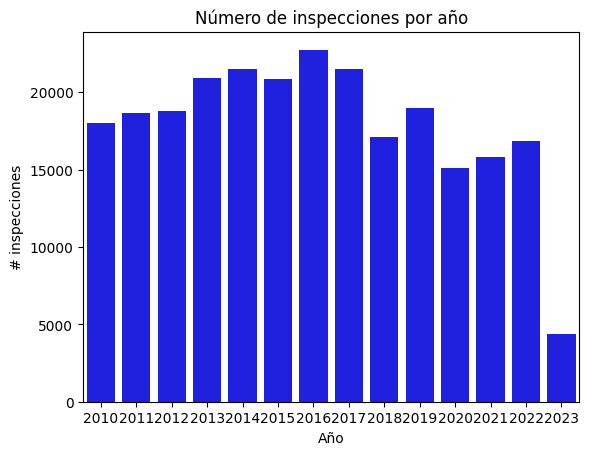

In [ ]:
#Utilizamos seaborn para graficar las inspecciones por año
a = sns.barplot(x="year_inspection", y="count", data=inspections_by_year, color="blue")
a.set_title("Número de inspecciones por año")
a.set_ylabel('# inspecciones')
a.set_xlabel("Año")

### 4. ¿Cuáles son las 5 inspecciones que más se realizan?

In [ ]:
#Agrupamos el dataset por tipo de inspección, contamos ,  ordenamos por id de inspección , tomamos 5 primeros.

top = dataset.groupby(['inspection_type'], as_index=False)['inspection_id']\
.count()\
.sort_values(by="inspection_id", ascending=False)\
.rename(columns={'inspection_id': 'count'})\
.head(5)

top

,inspection_type,count
15,Canvass,131215
44,License,33457
16,Canvass Re-Inspection,27206
17,Complaint,23752
45,License Re-Inspection,10899


Text(0.5, 1.0, 'Número de inspecciones por Tipo')

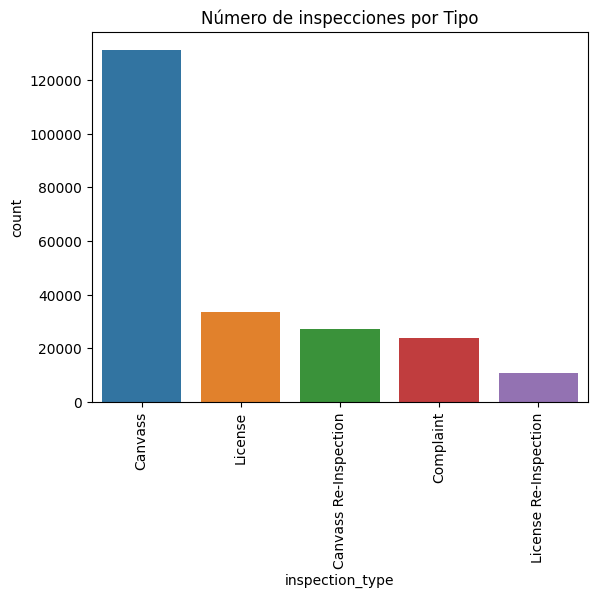

In [ ]:
#Utilizamos seaborn para graficar el número de inspecciones por Tipo
g = sns.barplot(x="inspection_type", y="count", data=top)
g.set_xticklabels(g.get_xticklabels(), rotation=90)
g.set_title("Número de inspecciones por Tipo")

### 5. Del top 5 de tipos de inspecciones que hay en tu dataset, ¿qué porcentaje representa cada uno de estos tipos de inspecciones? Genera una gráfica de barras


In [ ]:
#Del top 5 de tipos de inspección obtenemos cuanto representa cada uno en proporción
a = dataset.inspection_type.value_counts(normalize=True).sort_values(ascending=False).head(5)
a

Canvass                  0.522409
License                  0.133203
Canvass Re-Inspection    0.108316
Complaint                0.094564
License Re-Inspection    0.043392
Name: inspection_type, dtype: float64

In [ ]:
#Generamos indice y renombramos columna
b = pd.DataFrame({'inspection_type': a.index,
                 'prop': a})
b

,inspection_type,prop
Canvass,Canvass,0.522409
License,License,0.133203
Canvass Re-Inspection,Canvass Re-Inspection,0.108316
Complaint,Complaint,0.094564
License Re-Inspection,License Re-Inspection,0.043392


(0.0, 1.0)

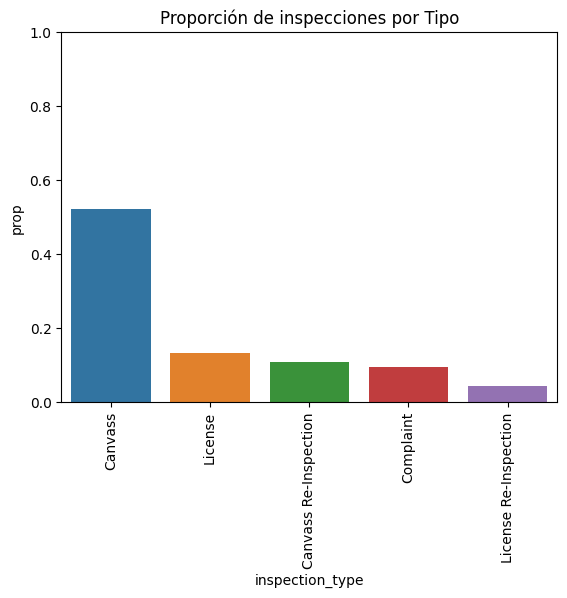

In [ ]:
#Utilizamos seaborn para graficar la proporcion de inspecciones por Tipo
g = sns.barplot(x="inspection_type", y="prop", data=b)
g.set_xticklabels(g.get_xticklabels(), rotation=90)
g.set_title("Proporción de inspecciones por Tipo")
g.set_ylim(0,1)

### 6. ¿Qué porcentaje de establecimientos tienes por cada tipo de resultado? Genera una gráfica de barras


In [ ]:
#Obtenemos proporción por cada tipo de resultado
a = dataset.results.value_counts(normalize=True)
a

Pass                    0.515053
Fail                    0.194164
Pass w/ Conditions      0.153985
Out of Business         0.085526
No Entry                0.038786
Not Ready               0.012175
Business Not Located    0.000311
Name: results, dtype: float64

In [ ]:
#Generamos indice y renombramos columna
b = pd.DataFrame({'result': a.index,
                 'prop': a})

(0.0, 1.0)

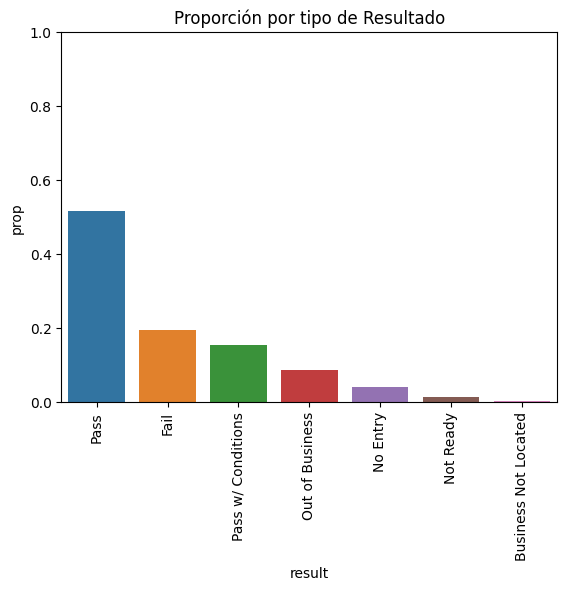

In [ ]:
#Utilizamos seaborn para graficar la proporción por cada tipo de resultados
g = sns.barplot(x='result', y='prop', data=b)
g.set_xticklabels(g.get_xticklabels(), rotation=90)
g.set_title("Proporción por tipo de Resultado")
g.set_ylim(0,1)

### 7. Mapa de inspecciones

In [ ]:
#Definimos el token de acceso a mapbox
px.set_mapbox_access_token(config['map']['map_token'])


In [ ]:
#Generamos el mapa de inspecciones, resaltando en colores los tipo de resultados y mostrando los datos de los establecimientos
fig = px.scatter_mapbox(dataset, lat="latitude", lon="longitude", hover_name="city", color="results",
                        hover_data=["aka_name", "facility_type"], zoom=9, height=400, opacity=0.3)
fig.show()

In [ ]:
#Montramos drive
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
#Convertimos mapa a html
import plotly.express as px

fig.write_html('/content/drive/MyDrive/Colab Notebooks/mapa.html')

In [ ]:
#Convertimos notebook a html
!jupyter nbconvert --to html /content/analisis_exploratorio_html2.ipynb